In [7]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import klib
from pandas_profiling import ProfileReport

In [2]:
os.chdir("C:\\Users\\rakes\\capstone EDA")

In [3]:
df = pd.read_csv("Next_Generation_Simulation__NGSIM__Vehicle_Trajectories_and_Supporting_Data.csv")

In [5]:
df['Preceding'].min()

0

In [8]:
df.rename(columns={'v_Vel' : 'Vehicle_Velocity'}, inplace=True)

GridSpec(6, 6)

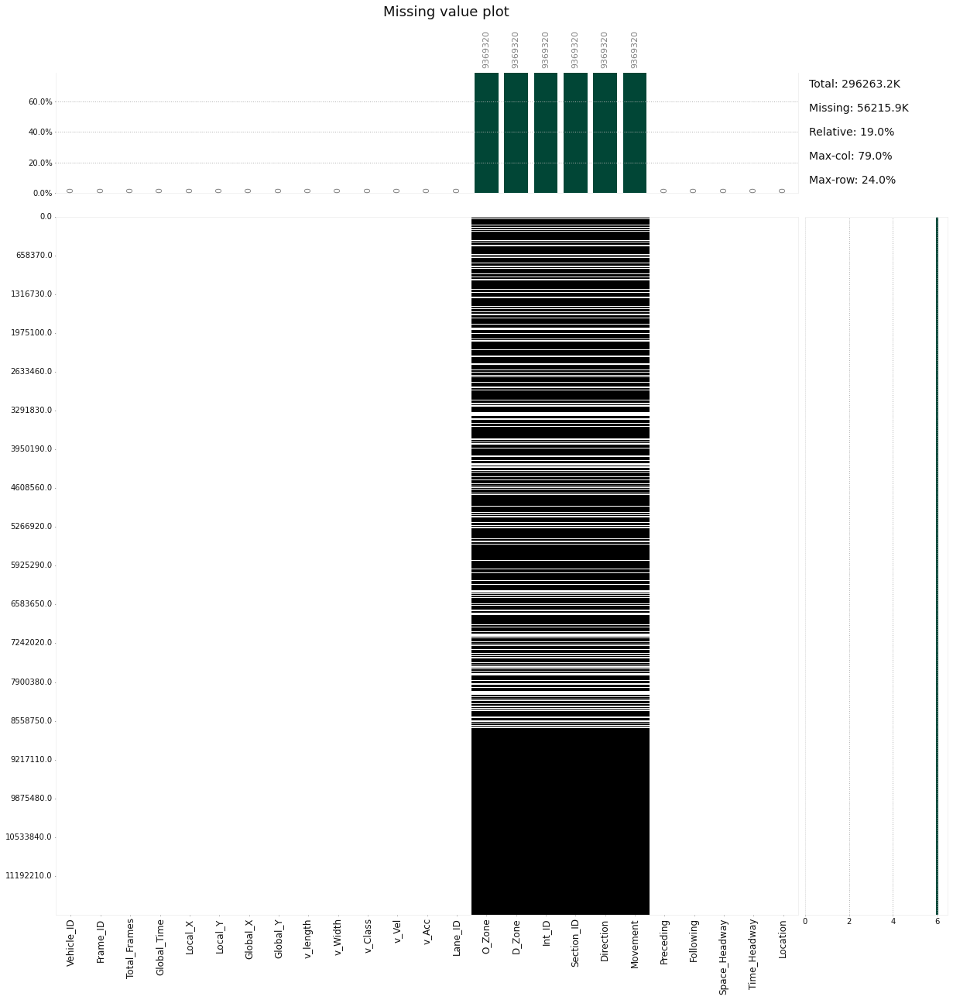

In [ ]:
klib.missingval_plot(df)

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

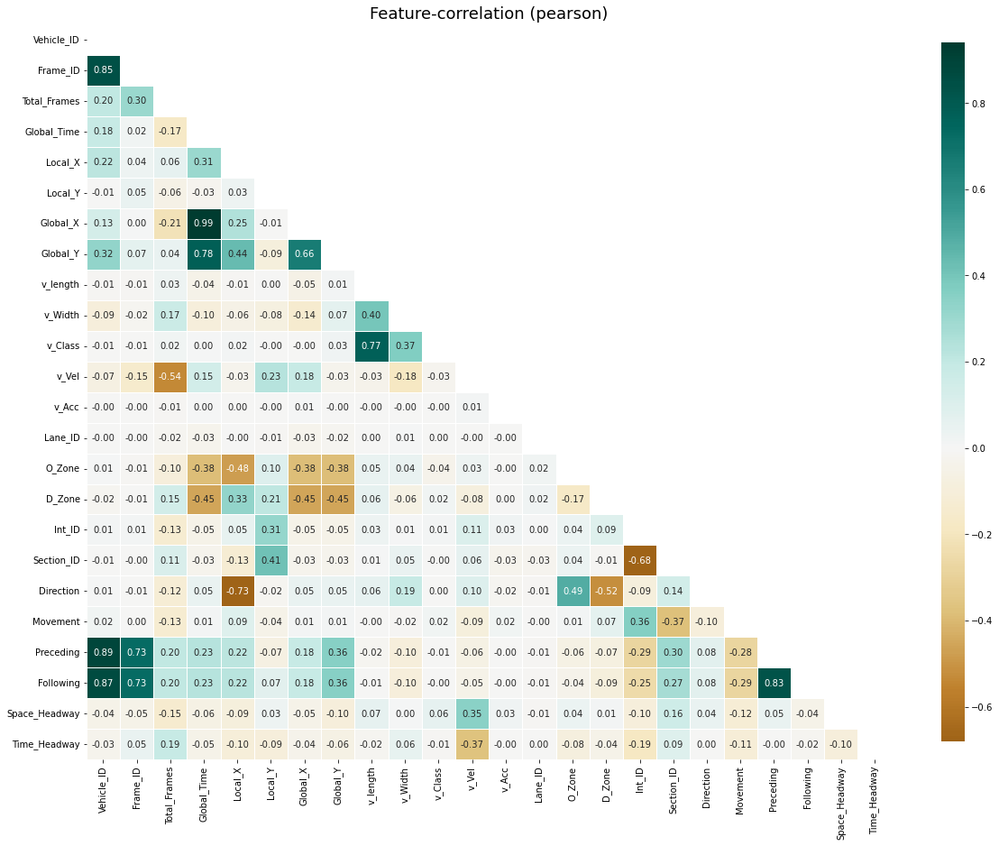

In [ ]:
klib.corr_plot(df, annot = True, figsize = (20,15))

<AxesSubplot:title={'center':'Feature-correlation (pearson)'}>

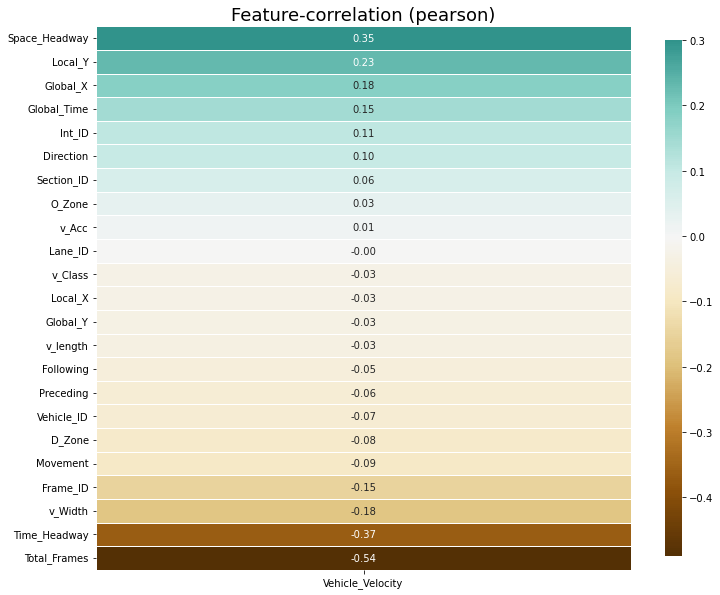

In [ ]:
# default representation of correlations with the feature column (Vehicle velocity)
klib.corr_plot(df, target='Vehicle_Velocity')


## Understanding the data

In [ ]:
df.head()

,Vehicle_ID,Frame_ID,Total_Frames,Global_Time,Local_X,Local_Y,Global_X,Global_Y,v_length,v_Width,...,D_Zone,Int_ID,Section_ID,Direction,Movement,Preceding,Following,Space_Headway,Time_Headway,Location
0,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,...,NaN,NaN,NaN,NaN,NaN,500,523,119.10,5.11,us-101
1,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,...,NaN,NaN,NaN,NaN,NaN,500,523,119.10,5.11,us-101
2,2224,6548,1902,1113437421700,41.429,472.901,6042814.264,2133542.012,14.3,6.9,...,NaN,NaN,NaN,NaN,NaN,2208,2211,53.34,2.01,i-80
3,2127,6459,567,1118847624800,19.632,1775.614,6452425.122,1872172.475,13.5,6.9,...,NaN,NaN,NaN,NaN,NaN,2124,2132,48.92,1.30,us-101
4,1033,4827,592,1118848324700,6.202,1701.144,6452347.673,1872258.452,13.5,4.4,...,NaN,NaN,NaN,NaN,NaN,1029,1040,38.81,0.92,us-101


In [ ]:
df.shape

(11850526, 25)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11850526 entries, 0 to 11850525
Data columns (total 25 columns):
 #   Column         Dtype  
---  ------         -----  
 0   Vehicle_ID     int64  
 1   Frame_ID       int64  
 2   Total_Frames   int64  
 3   Global_Time    int64  
 4   Local_X        float64
 5   Local_Y        float64
 6   Global_X       float64
 7   Global_Y       float64
 8   v_length       float64
 9   v_Width        float64
 10  v_Class        int64  
 11  v_Vel          float64
 12  v_Acc          float64
 13  Lane_ID        int64  
 14  O_Zone         float64
 15  D_Zone         float64
 16  Int_ID         float64
 17  Section_ID     float64
 18  Direction      float64
 19  Movement       float64
 20  Preceding      int64  
 21  Following      int64  
 22  Space_Headway  float64
 23  Time_Headway   float64
 24  Location       object 
dtypes: float64(16), int64(8), object(1)
memory usage: 2.2+ GB


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Vehicle_ID,11850526.0,1.272563e+03,7.792891e+02,1.000000e+00,6.330000e+02,1.195000e+03,1.824000e+03,3.366000e+03
Frame_ID,11850526.0,5.174503e+03,2.608943e+03,1.000000e+00,2.987000e+03,5.222000e+03,7.354000e+03,1.169100e+04
Total_Frames,11850526.0,8.930487e+02,4.020496e+02,2.000000e+00,6.190000e+02,8.240000e+02,1.038000e+03,2.434000e+03
Global_Time,11850526.0,1.034354e+12,2.915348e+11,1.163019e+09,1.113437e+12,1.118847e+12,1.118849e+12,1.118938e+12
Local_X,11850526.0,2.794686e+01,2.495012e+01,-3.256250e+02,1.453300e+01,2.932300e+01,4.332900e+01,1.608840e+02
Local_Y,11850526.0,9.168111e+02,5.502644e+02,0.000000e+00,4.512030e+02,8.573970e+02,1.351873e+03,2.235252e+03
Global_X,11850526.0,5.982983e+06,1.076391e+06,2.230210e+06,6.042757e+06,6.451253e+06,6.452048e+06,6.452741e+06
Global_Y,11850526.0,1.936843e+06,2.008363e+05,1.375533e+06,1.872593e+06,1.873236e+06,2.133669e+06,2.134845e+06
v_length,11850526.0,1.569627e+01,5.611962e+00,3.500000e+00,1.380000e+01,1.500000e+01,1.600000e+01,7.770000e+01
v_Width,11850526.0,6.626444e+00,8.725600e-01,2.000000e+00,5.900000e+00,6.800000e+00,7.000000e+00,8.500000e+00


In [ ]:
df.isnull().sum()

Vehicle_ID             0
Frame_ID               0
Total_Frames           0
Global_Time            0
Local_X                0
Local_Y                0
Global_X               0
Global_Y               0
v_length               0
v_Width                0
v_Class                0
v_Vel                  0
v_Acc                  0
Lane_ID                0
O_Zone           9369320
D_Zone           9369320
Int_ID           9369320
Section_ID       9369320
Direction        9369320
Movement         9369320
Preceding              0
Following              0
Space_Headway          0
Time_Headway           0
Location               0
dtype: int64

In [ ]:
df.columns

Index(['Vehicle_ID', 'Frame_ID', 'Total_Frames', 'Global_Time', 'Local_X',
       'Local_Y', 'Global_X', 'Global_Y', 'v_length', 'v_Width', 'v_Class',
       'v_Vel', 'v_Acc', 'Lane_ID', 'O_Zone', 'D_Zone', 'Int_ID', 'Section_ID',
       'Direction', 'Movement', 'Preceding', 'Following', 'Space_Headway',
       'Time_Headway', 'Location'],
      dtype='object')

In [ ]:
df.nunique()

Vehicle_ID          3233
Frame_ID           11691
Total_Frames        1837
Global_Time        88516
Local_X           151978
Local_Y          2012945
Global_X         2007060
Global_Y         3833428
v_length             362
v_Width               58
v_Class                3
v_Vel               8986
v_Acc               3167
Lane_ID               18
O_Zone                22
D_Zone                20
Int_ID                 6
Section_ID             7
Direction              4
Movement               3
Preceding           3228
Following           3234
Space_Headway      88292
Time_Headway       64492
Location               4
dtype: int64

In [ ]:
# Percentage of missing values in dataset
df.isnull().mean().round(4)*100

Vehicle_ID        0.00
Frame_ID          0.00
Total_Frames      0.00
Global_Time       0.00
Local_X           0.00
Local_Y           0.00
Global_X          0.00
Global_Y          0.00
v_length          0.00
v_Width           0.00
v_Class           0.00
v_Vel             0.00
v_Acc             0.00
Lane_ID           0.00
O_Zone           79.06
D_Zone           79.06
Int_ID           79.06
Section_ID       79.06
Direction        79.06
Movement         79.06
Preceding         0.00
Following         0.00
Space_Headway     0.00
Time_Headway      0.00
Location          0.00
dtype: float64

## Relationship analysis

In [ ]:
corelation = df.corr()

<AxesSubplot:>

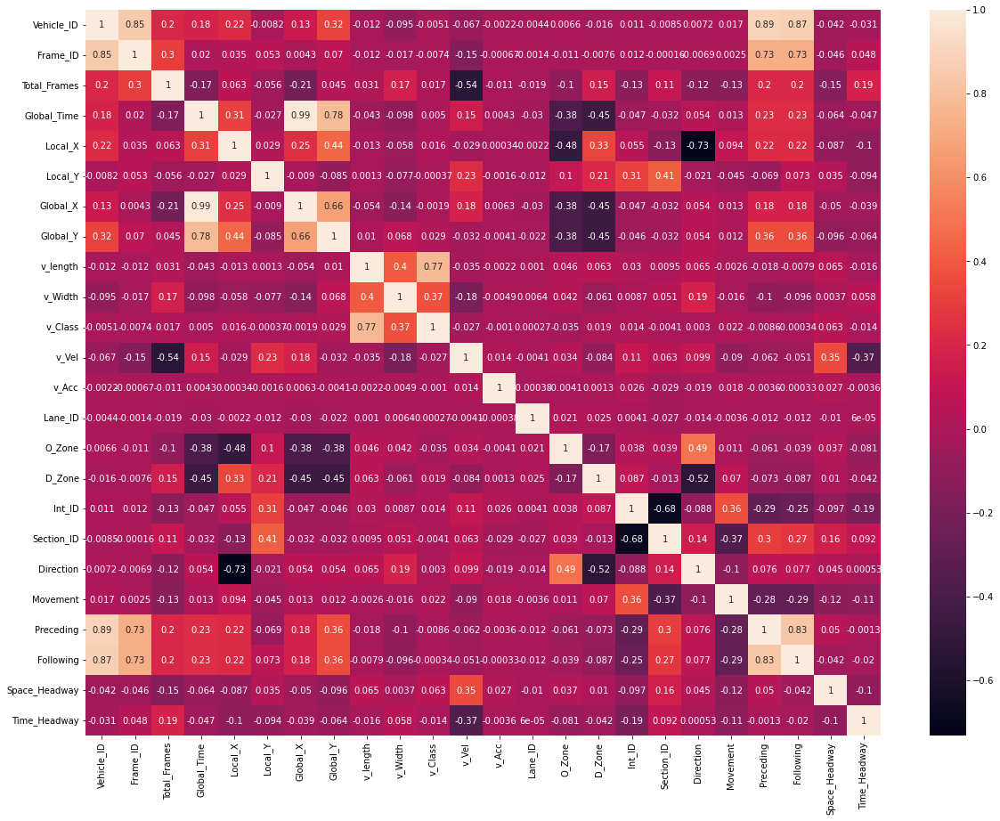

In [ ]:
corelation = df.corr()
plt.figure(figsize=(20,15))
sns.heatmap(corelation, xticklabels=corelation.columns, yticklabels=corelation.columns, annot=True)

In [ ]:
# sns.pairplot(df)

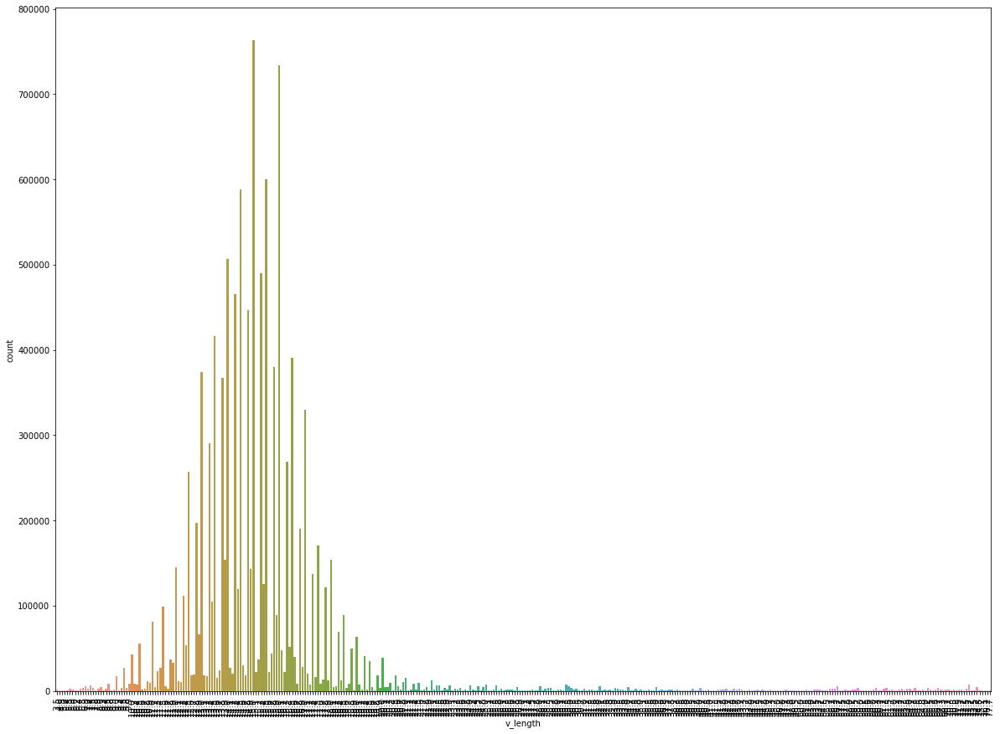

In [ ]:
plt.figure(figsize=(20,15))
sns.countplot(data = df, x = "v_length")
plt.xticks(rotation=90)
plt.show()

<AxesSubplot:xlabel='Location', ylabel='count'>

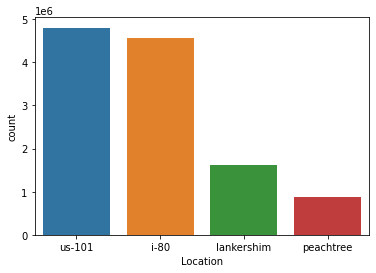

In [ ]:
sns.countplot(data = df, x = "Location")

In [ ]:
df1 = df

In [ ]:
df1["Vehicle_class"] = df["v_Class"].map({1:"motorcycle", 2: "auto", 3: "truck"})

In [ ]:
df1.head()

,Vehicle_ID,Frame_ID,Total_Frames,Global_Time,Local_X,Local_Y,Global_X,Global_Y,v_length,v_Width,...,Int_ID,Section_ID,Direction,Movement,Preceding,Following,Space_Headway,Time_Headway,Location,Vehicle_class
0,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,...,NaN,NaN,NaN,NaN,500,523,119.10,5.11,us-101,auto
1,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,...,NaN,NaN,NaN,NaN,500,523,119.10,5.11,us-101,auto
2,2224,6548,1902,1113437421700,41.429,472.901,6042814.264,2133542.012,14.3,6.9,...,NaN,NaN,NaN,NaN,2208,2211,53.34,2.01,i-80,auto
3,2127,6459,567,1118847624800,19.632,1775.614,6452425.122,1872172.475,13.5,6.9,...,NaN,NaN,NaN,NaN,2124,2132,48.92,1.30,us-101,auto
4,1033,4827,592,1118848324700,6.202,1701.144,6452347.673,1872258.452,13.5,4.4,...,NaN,NaN,NaN,NaN,1029,1040,38.81,0.92,us-101,auto


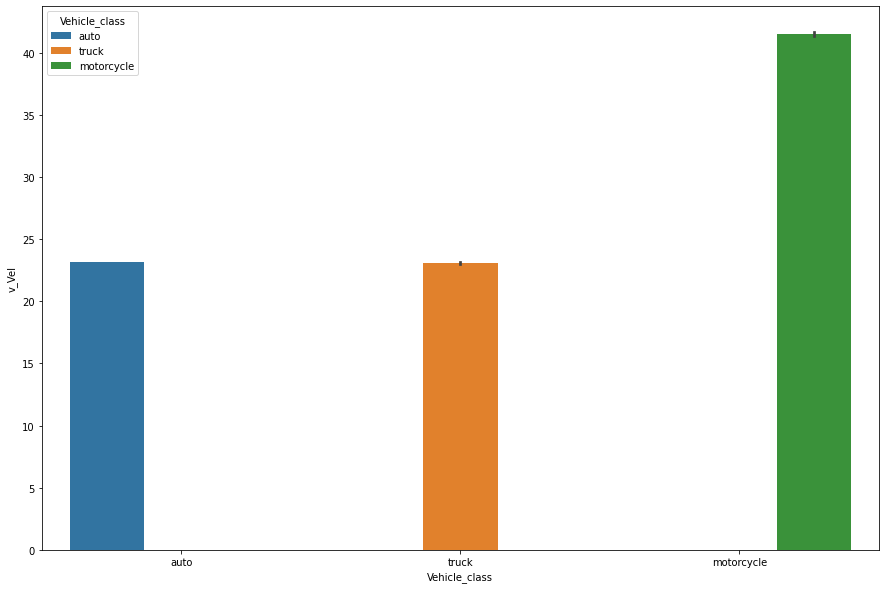

In [ ]:
plt.figure(figsize=(15,10))
sns.barplot(data = df1, x = "Vehicle_class", y = "v_Vel", hue = df["Vehicle_class"])
#plt.xticks([1,2,3], ["motorcycle", "auto", "truck"])
#plt.legend(title='Vehicle class', labels=['motorcycle', 'auto', 'truck'])
plt.show()x

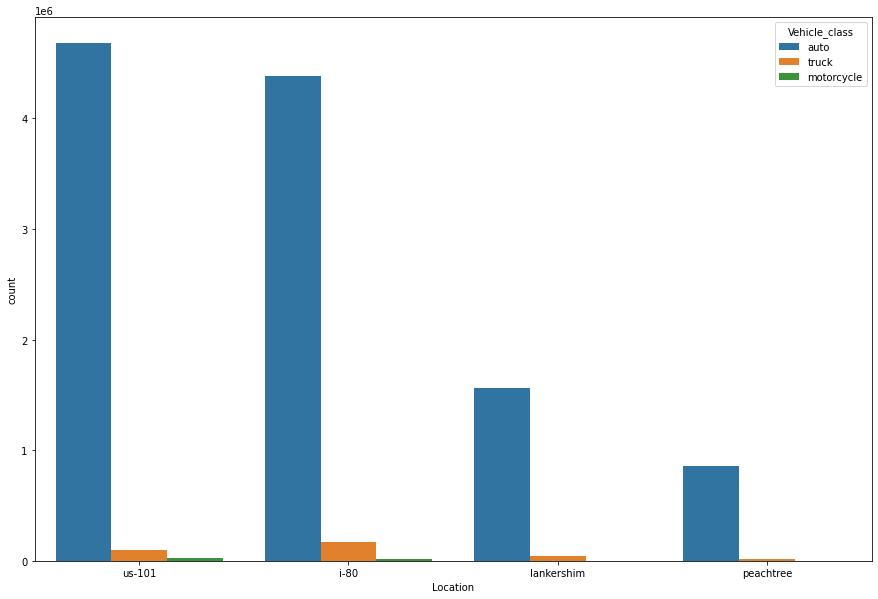

In [ ]:
plt.figure(figsize=(15,10))
sns.countplot(data = df1, x= "Location", hue = df["Vehicle_class"])
plt.show()

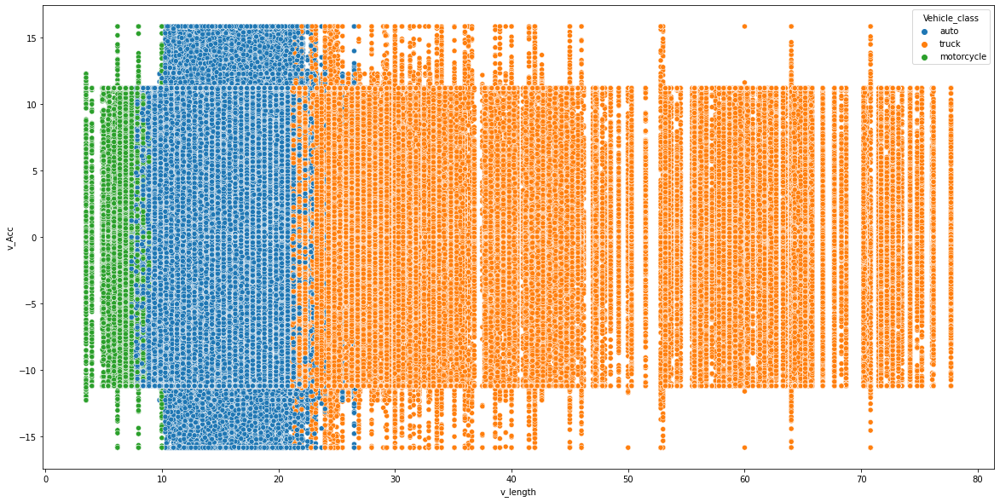

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(data = df1, x = "v_length", y = "v_Acc", hue = df["Vehicle_class"])
plt.show()

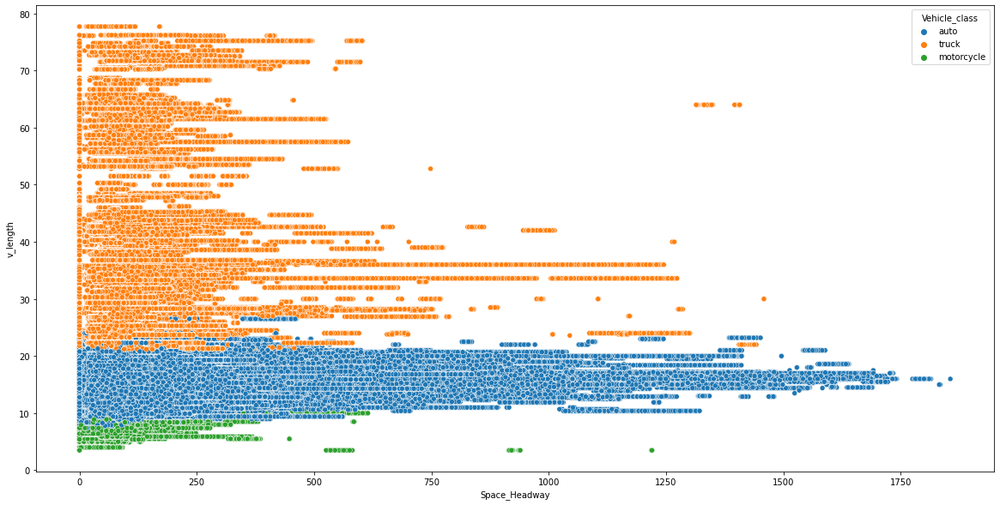

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df1,x='Space_Headway',y='v_length',hue='Vehicle_class')
plt.show()

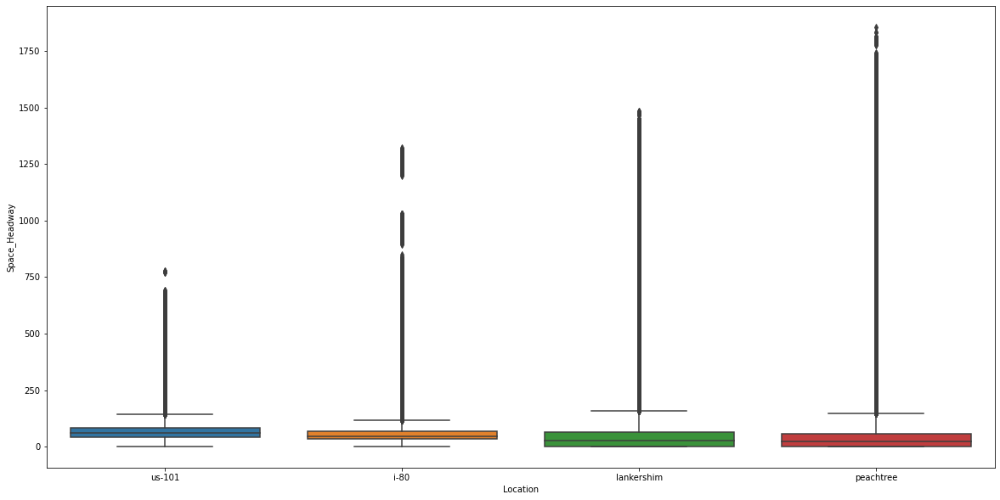

In [ ]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df,y='Space_Headway',x='Location')
plt.show()

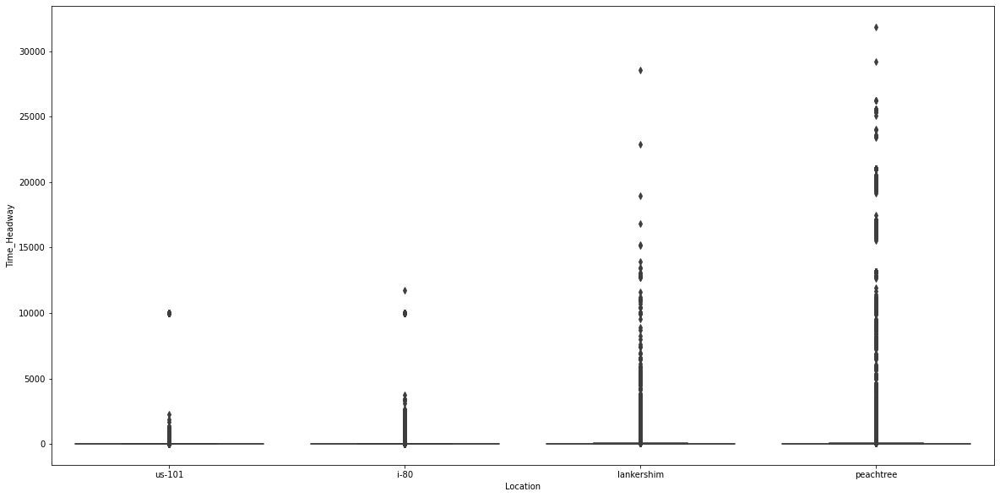

In [ ]:
plt.figure(figsize=(20,10))
sns.boxplot(data=df,y='Time_Headway',x='Location')
plt.show()

In [ ]:
df1["Direction_text"] = df["Direction"].map({1:"east-bound (EB)", 2: "north-bound (NB)", 3: "west-bound (WB)", 4: "south-bound (SB)"})

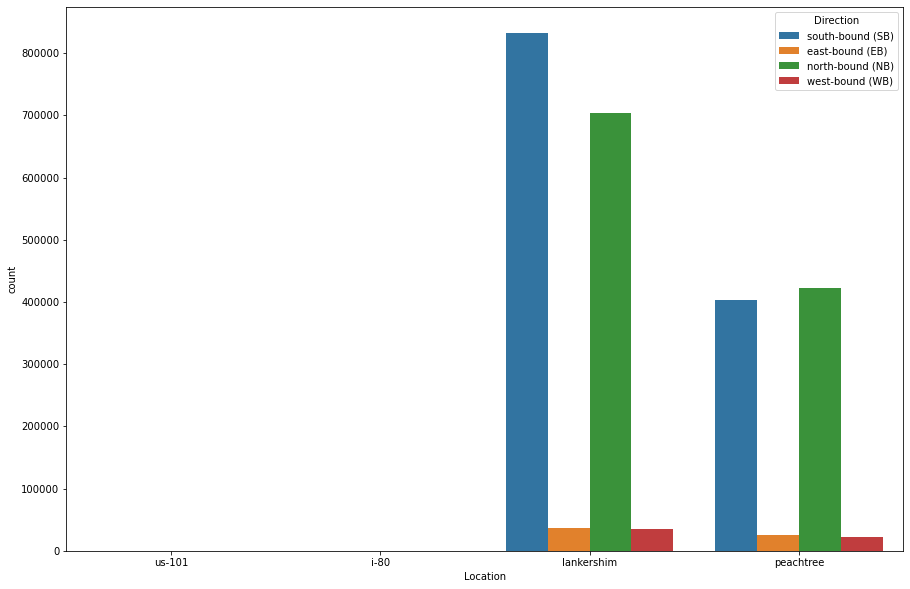

In [ ]:
plt.figure(figsize=(15,10))
sns.countplot(data = df1, x= "Location", hue = df["Direction_text"])
plt.legend(title='Direction')
plt.show()

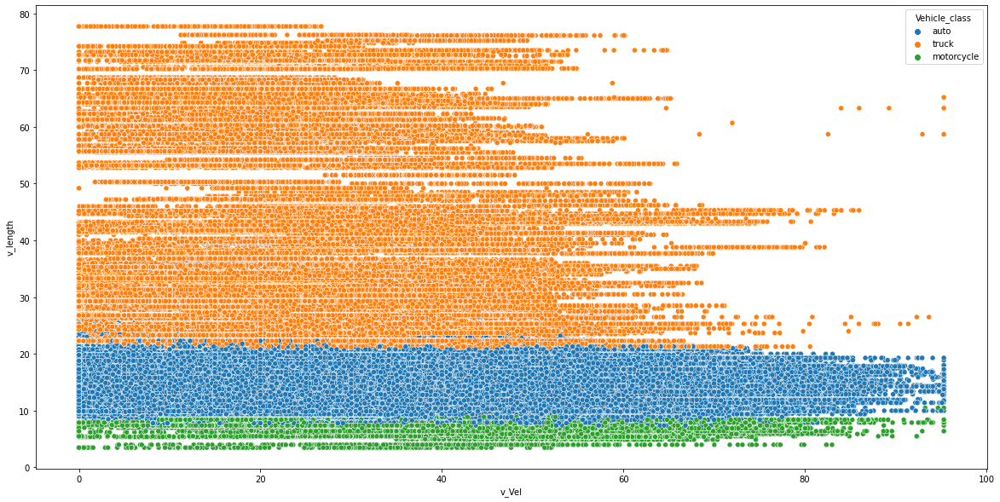

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df1,x='Vehicle_Velocity',y='v_length',hue='Vehicle_class')
plt.show()

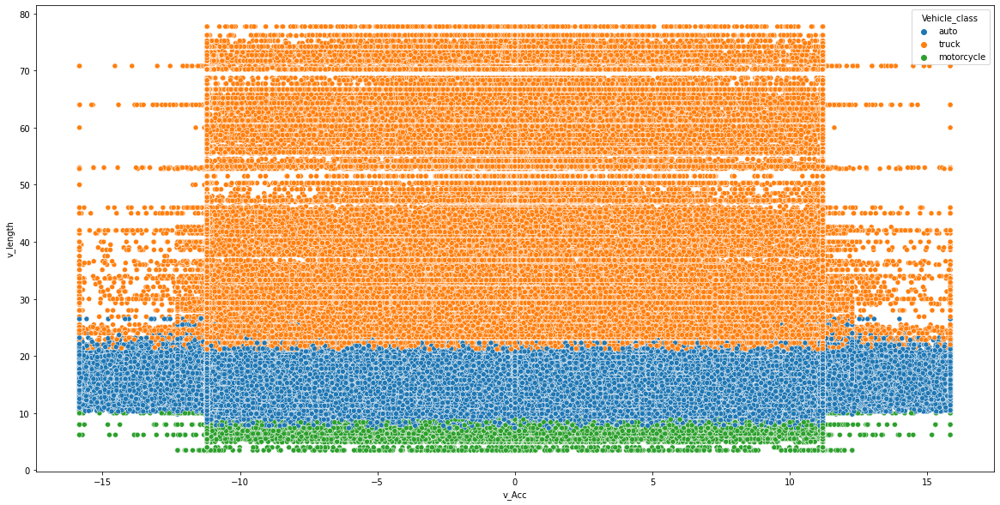

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(data=df1,x='v_Acc',y='v_length',hue='Vehicle_class')
plt.show()

In [ ]:
df[['Vehicle_ID','Preceding', 'Following']].nunique()

Vehicle_ID    3233
Preceding     3228
Following     3234
dtype: int64

In [ ]:
df[['Vehicle_ID', 'v_Class', 'Preceding', 'Following']]

,Vehicle_ID,v_Class,Preceding,Following
0,515,2,500,523
1,515,2,500,523
2,2224,2,2208,2211
3,2127,2,2124,2132
4,1033,2,1029,1040
...,...,...,...,...
11850521,1355,2,1351,1361
11850522,1474,2,1468,1480
11850523,398,2,385,406
11850524,599,2,0,611


In [9]:
df2 = df[((df['Vehicle_ID']==29) & (df['Preceding']==157)) | ((df['Vehicle_ID']==152) & (df['Preceding']==157)) | ((df['Vehicle_ID']==186) & (df['Preceding']==29))]

In [10]:
def pair(row):
  if row['Vehicle_ID'] == 29:
    return 'M - A'
  elif row['Vehicle_ID'] == 152:
    return 'A - A'
  elif row['Vehicle_ID'] == 186:
    return 'A - M'
  else:
    return 'Undefined'

df2['pair'] = df2.apply(pair, axis=1)

C:\Users\rakes\AppData\Local\Temp\ipykernel_26716\1288301932.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['pair'] = df2.apply(pair, axis=1)


In [11]:
df2[df2['Vehicle_ID']==29]

,Vehicle_ID,Frame_ID,Total_Frames,Global_Time,Local_X,Local_Y,Global_X,Global_Y,v_length,v_Width,...,Int_ID,Section_ID,Direction,Movement,Preceding,Following,Space_Headway,Time_Headway,Location,pair
249238,29,850,1144,1163115300,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A
829096,29,852,1144,1163115500,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A
1681776,29,851,1144,1163115400,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A
3300518,29,854,1144,1163115700,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A
5400573,29,849,1144,1163115200,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A
7003063,29,853,1144,1163115600,-17.179,271.405,2230518.917,1375804.598,3.5,6.5,...,0.0,2.0,4.0,1.0,157,1669,0.0,0.0,peachtree,M - A


In [12]:
df2.columns

Index(['Vehicle_ID', 'Frame_ID', 'Total_Frames', 'Global_Time', 'Local_X',
       'Local_Y', 'Global_X', 'Global_Y', 'v_length', 'v_Width', 'v_Class',
       'Vehicle_Velocity', 'v_Acc', 'Lane_ID', 'O_Zone', 'D_Zone', 'Int_ID',
       'Section_ID', 'Direction', 'Movement', 'Preceding', 'Following',
       'Space_Headway', 'Time_Headway', 'Location', 'pair'],
      dtype='object')

In [13]:
df2["pair"].unique()

array(['A - A', 'M - A', 'A - M'], dtype=object)

In [15]:
df2 = df2[(df2["Location"] == "us-101") | (df2["Location"] == "i-80")]

<AxesSubplot:xlabel='Vehicle_Velocity', ylabel='Space_Headway'>

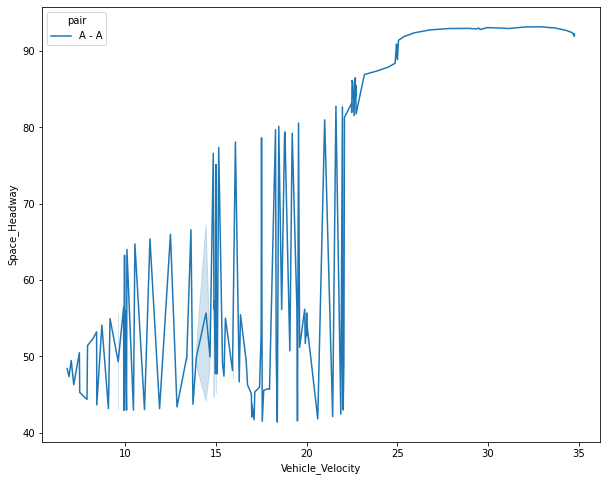

In [17]:
plt.figure(figsize=(10,8))
sns.lineplot(x = 'Vehicle_Velocity', y = 'Space_Headway', hue='pair', data=df2)

## EDA Part 2

In [18]:
filtered_ngsim= df[((df['Location'] == 'us-101') | (df['Location'] == 'i-80')) & (df['Preceding']>0) & (df['Following']>0) ]
filtered_ngsim= filtered_ngsim.drop(columns=['Movement', 'Direction','Section_ID','Int_ID','D_Zone','O_Zone','Lane_ID'])

In [19]:
filtered_ngsim['Preceding_Vehicle_Class'] = np.NaN
filtered_ngsim['Following_Vehicle_Class'] = np.NaN

In [20]:
filtered_ngsim.head(5)

,Vehicle_ID,Frame_ID,Total_Frames,Global_Time,Local_X,Local_Y,Global_X,Global_Y,v_length,v_Width,v_Class,Vehicle_Velocity,v_Acc,Preceding,Following,Space_Headway,Time_Headway,Location,Preceding_Vehicle_Class,Following_Vehicle_Class
0,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,2,23.31,2.05,500,523,119.10,5.11,us-101,NaN,NaN
1,515,2330,1123,1118848075000,30.034,188.062,6451203.729,1873252.549,13.0,6.9,2,23.31,2.05,500,523,119.10,5.11,us-101,NaN,NaN
2,2224,6548,1902,1113437421700,41.429,472.901,6042814.264,2133542.012,14.3,6.9,2,26.54,-0.76,2208,2211,53.34,2.01,i-80,NaN,NaN
3,2127,6459,567,1118847624800,19.632,1775.614,6452425.122,1872172.475,13.5,6.9,2,37.52,11.20,2124,2132,48.92,1.30,us-101,NaN,NaN
4,1033,4827,592,1118848324700,6.202,1701.144,6452347.673,1872258.452,13.5,4.4,2,41.99,0.10,1029,1040,38.81,0.92,us-101,NaN,NaN


In [8]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [9]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
profile.to_file("NGSIM_Dataset_Report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]